In [1]:
from engine import *
from diffusion import *

from matplotlib import pyplot as plt

A matching Triton is not available, some optimizations will not be enabled.
Error caught was: No module named 'triton'


In [8]:
skretch = gen_farm()

skretch = add_skies(skretch, 4, Z = 200)

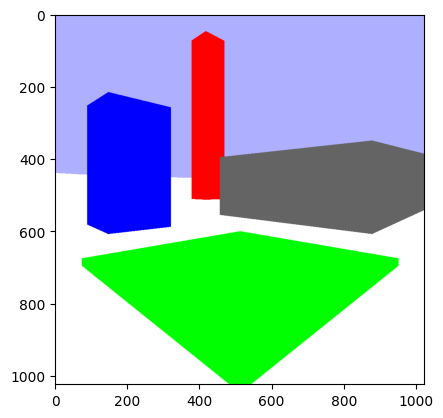

In [9]:
verbose = 0
linewidth = 0
pov = Point(0,0,12)
direction = Point(1,1,-0.1)
vision_angle = 35

sc1 = Scene(skretch, pov, direction, resolution = (1024,1024), vision_angle = 35, verbose = verbose, linewidth = linewidth)

seg_map = sc1.get_seg_map()
plt.imshow(seg_map)

In [10]:
prompt = "a countryside farm. Bright skies. Epic realistic, (hdr:1.4), (muted colors:1.4), abandoned, (intricate details), (intricate details, hyperdetailed:1.4), artstation, vignette"
device = "cuda"
model = "realistic"
control = ["seg"]
steps = 200

stamped_img, src = run_diffusion(sc1 , device = device, prompt = prompt, model = model, control = control, steps = steps)

Keyword arguments {'controlnet_conditioning_scale': 1.0} are not expected by StableDiffusionControlNetPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]



present([src], [stamped_img])

In [42]:
pov = Point(0,10,40)
direction = Point(1,0.9,-0.1)
sc2 = Scene(skretch, pov, direction, resolution = (1024,1024), vision_angle = 35, verbose = verbose, linewidth = linewidth)

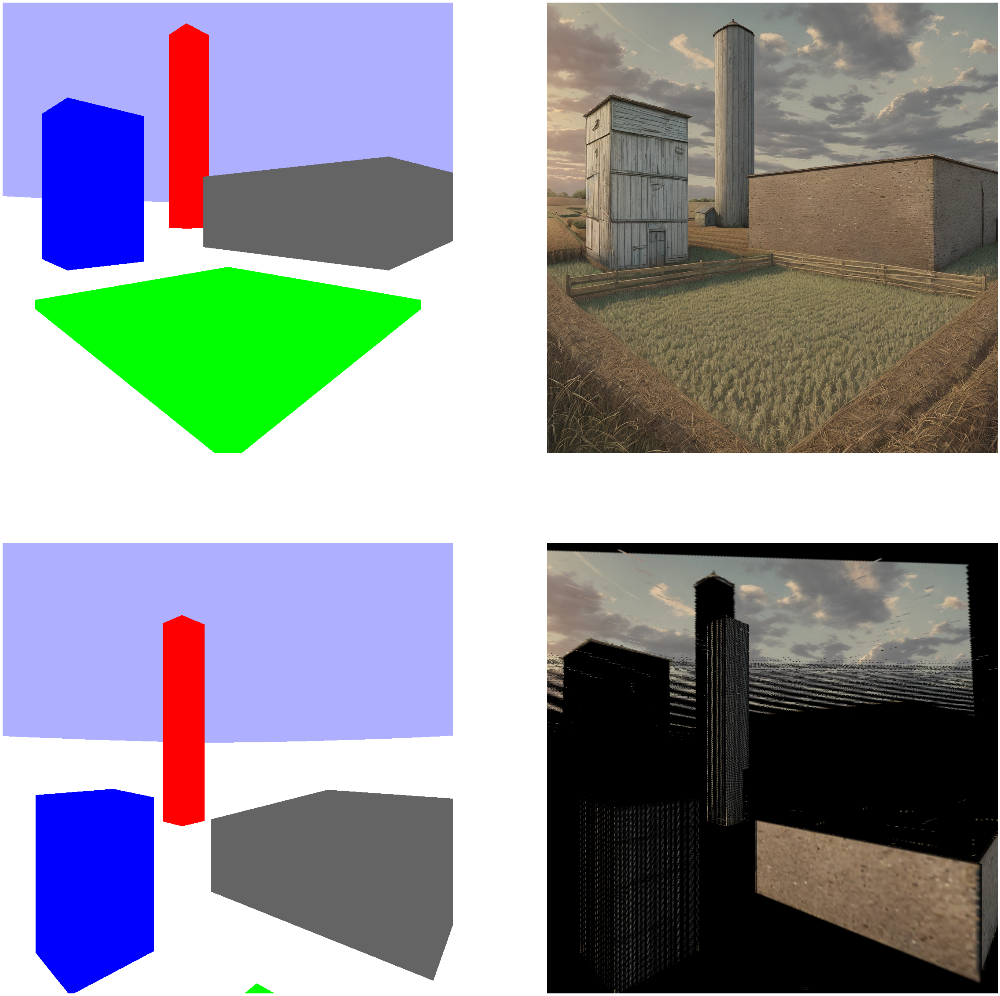

In [43]:
sc1.transition(sc2, intensity = 1.0)

src = [[sc.get_seg_map()] for sc in [sc1,sc2]] 
results = [sc.get_image() for sc in [sc1,sc2]]

present(src, results)

In [41]:
def run_inpainting(scene , device = "cuda", prompt = None, model = "realistic", control = "seg", steps = 200, strength = 1.0):
    if prompt is None:
        prompt = "a countryside farm. Epic realistic, (hdr:1.4), (muted colors:1.4), abandoned, (intricate details), (intricate details, hyperdetailed:1.4), artstation, vignette"

    model_id_or_path = get_model_path(model)

    controlnets, mconds = get_controls(control, scene)

    # pipe = StableDiffusionControlNetImg2ImgPipeline.from_pretrained(
    #     model_id_or_path, controlnet=controlnets, safety_checker=None, torch_dtype=torch.float16
    # )
    
    pipe = StableDiffusionControlNetInpaintPipeline.from_pretrained(
        model_id_or_path, controlnet=controlnets, safety_checker=None, torch_dtype=torch.float16
    )

    pipe = pipe.to(device)

    pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

    pipe.enable_xformers_memory_efficient_attention()

    pipe.enable_model_cpu_offload()

    start_image = scene.get_image()

    mask = (np.where(start_image == (0,0,0), 1, 0).sum(2)==3)
    
    ##mask = np.float32(mask)
    
    # kernel = np.ones((3,3),np.float)
    # mask = cv2.dilate(mask,kernel,iterations = 1)
    # import pdb; pdb.set_trace()
    
    mask = mask.astype(np.uint8)

    plt.imshow(mask)
    plt.show()

    
    image = pipe(prompt, image=start_image, mask_image=mask, control_image= mconds, 
                         strength = strength, num_inference_steps=steps,
                         height=1024, width=1024).images[0]

    stamp_image = np.asarray(image)

    ##scene.set_image(stamp_image)


    return stamp_image, mconds

vae/diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet_inpaint.StableDiffusionControlNetInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


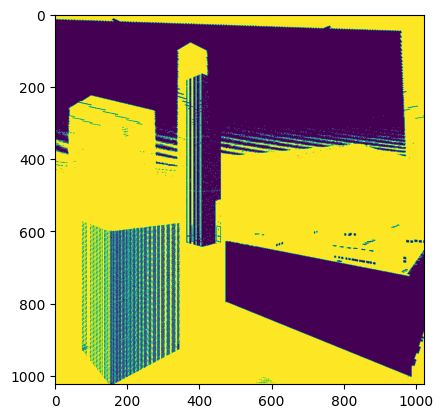

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:1                                                                                    │
│                                                                                                  │
│ ❱ 1 stamped_img, src = run_inpainting(sc2 , device = device, prompt = prompt, model = model,     │
│   2                                                                                              │
│   3 src = [[sc.get_seg_map()] for sc in [sc1,sc2]]                                               │
│   4 results = [sc.get_image() for sc in [sc1,sc2]]                                               │
│                                                                                                  │
│ in run_inpainting:41                                                                             │
│                                                                                                  │
│   38 │   plt.show()                                                                              │
│   39 │                                                                                           │
│   40 │                                                                                           │
│ ❱ 41 │   image = pipe(prompt, image=start_image, mask_image=mask, control_image= mconds,         │
│   42 │   │   │   │   │   │    strength = strength, num_inference_steps=steps,                    │
│   43 │   │   │   │   │   │    height=1024, width=1024).images[0]                                 │
│   44                                                                                             │
│                                                                                                  │
│ /home/yaniv/anaconda3/envs/pytorch/lib/python3.10/site-packages/torch/autograd/grad_mode.py:27   │
│ in decorate_context                                                                              │
│                                                                                                  │
│    24 │   │   @functools.wraps(func)                                                             │
│    25 │   │   def decorate_context(*args, **kwargs):                                             │
│    26 │   │   │   with self.clone():                                                             │
│ ❱  27 │   │   │   │   return func(*args, **kwargs)                                               │
│    28 │   │   return cast(F, decorate_context)                                                   │
│    29 │                                                                                          │
│    30 │   def _wrap_generator(self, func):                                                       │
│                                                                                                  │
│ /home/yaniv/anaconda3/envs/pytorch/lib/python3.10/site-packages/diffusers/pipelines/controlnet/p │
│ ipeline_controlnet_inpaint.py:1180 in __call__                                                   │
│                                                                                                  │
│   1177 │   │   │   assert False                                                                  │
│   1178 │   │                                                                                     │
│   1179 │   │   # 4. Preprocess mask and image - resizes image and mask w.r.t height and width    │
│ ❱ 1180 │   │   mask, masked_image, init_image = prepare_mask_and_masked_image(                   │
│   1181 │   │   │   image, mask_image, height, width, return_image=True                           │
│   1182 │   │   )                                                                                 │
│   1183                                                                                           │
│                                                            

In [40]:
stamped_img, src = run_inpainting(sc2 , device = device, prompt = prompt, model = model, control = control, steps = 100, strength = 1.0)

src = [[sc.get_seg_map()] for sc in [sc1,sc2]] 
results = [sc.get_image() for sc in [sc1,sc2]]

present(src, results)

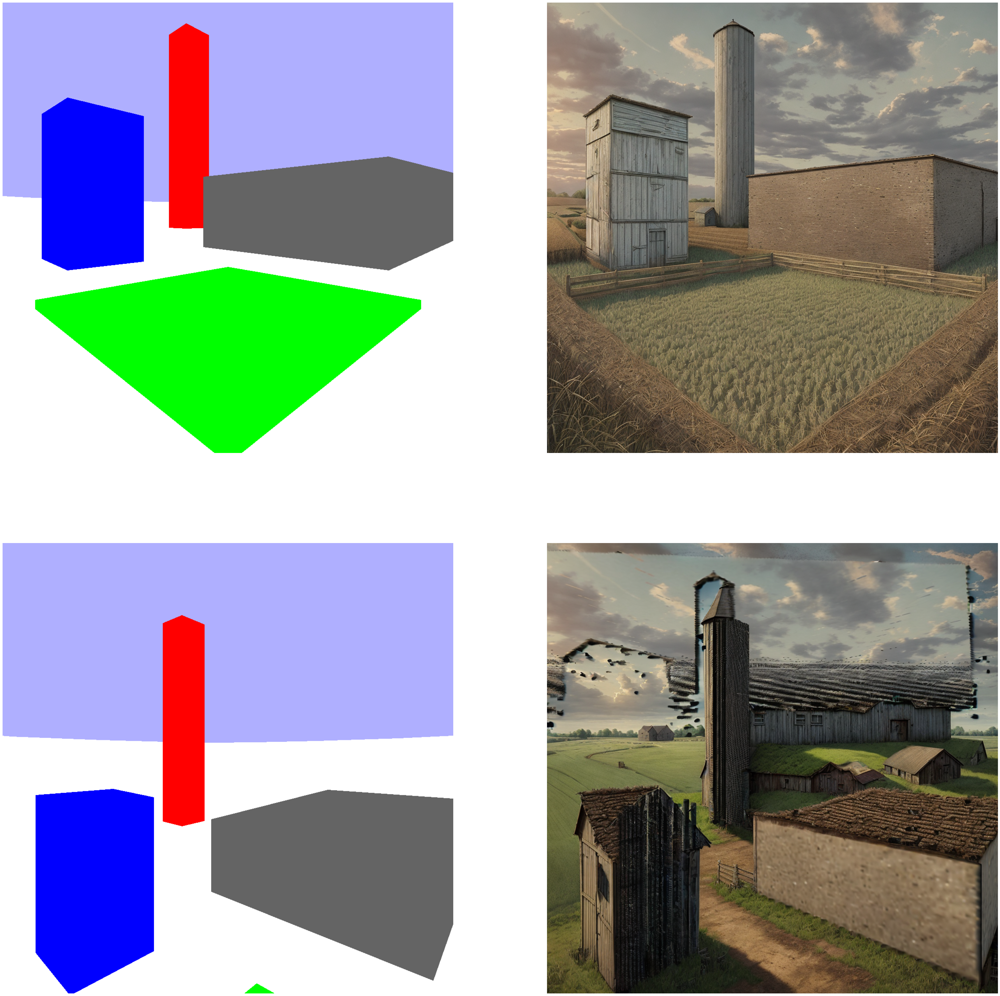

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/160 [00:00<?, ?it/s]

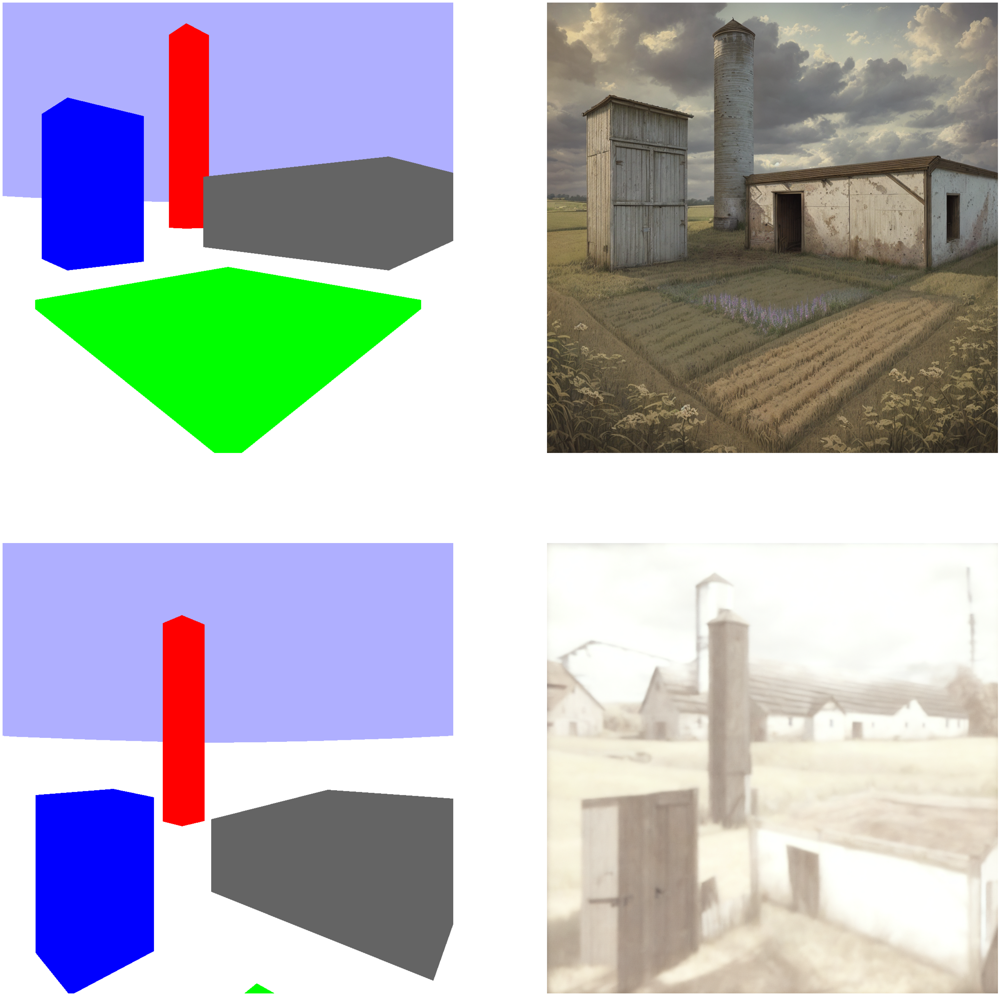

In [12]:
# def run_refine(scene , device = "cuda", prompt = None, steps = 200, strength = 1.0):
#     if prompt is None:
#         prompt = "a countryside farm. Epic realistic, (hdr:1.4), (muted colors:1.4), abandoned, (intricate details), (intricate details, hyperdetailed:1.4), artstation, vignette"

#     pipe = StableDiffusionXLImg2ImgPipeline.from_pretrained(
#         "stabilityai/stable-diffusion-xl-refiner-1.0", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
#     )

#     pipe = pipe.to(device)

#     pipe.enable_xformers_memory_efficient_attention()

#     pipe.enable_model_cpu_offload()

#     start_image = scene.get_image()

#     ##import pdb; pdb.set_trace()

#     image = pipe(prompt, image=start_image, strength = strength, 
#                          num_inference_steps=steps, ).images[0]

#     output_image = np.asarray(image)

#     scene.set_image(output_image)

#     return stamp_image

def run_img2img(scene , device = "cuda", prompt = None, model = "realistic", control = "seg", steps = 200, strength = 1.0):
    if prompt is None:
        prompt = "a countryside farm. Epic realistic, (hdr:1.4), (muted colors:1.4), abandoned, (intricate details), (intricate details, hyperdetailed:1.4), artstation, vignette"

    model_id_or_path = get_model_path(model)

    controlnets, mconds = get_controls(control, scene)

    pipe = StableDiffusionControlNetImg2ImgPipeline.from_pretrained(
        model_id_or_path, controlnet=controlnets, safety_checker=None, torch_dtype=torch.float16
    )
    
    # pipe = StableDiffusionControlNetInpaintPipeline.from_pretrained(
    #     model_id_or_path, controlnet=controlnets, safety_checker=None, torch_dtype=torch.float16
    # )

    pipe = pipe.to(device)

    pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

    pipe.enable_xformers_memory_efficient_attention()

    pipe.enable_model_cpu_offload()

    start_image = scene.get_image()

    image = pipe(prompt, image=start_image, control_image= mconds, 
                         strength = strength, num_inference_steps=steps,
                         height=1024, width=1024).images[0]
    
    stamp_image = np.asarray(image)

    print("before:")
    plt.imshow(start_image)
    plt.show()
    print("stamp image shape: ", stamp_image.shape)
    plt.imshow(stamp_image)
    plt.show()

    ##scene.set_image(stamp_image)

    return stamp_image, mconds




run_img2img(sc2 , device = device, prompt = prompt, steps = 800, strength = 0.5, model = "realistic", control = ["seg"])

src = [[sc.get_seg_map()] for sc in [sc1,sc2]] 
results = [sc.get_image() for sc in [sc1,sc2]]

present(src, results)